# Predicting heart disease using machine learning

This notebook looks into using various Python-based machine learning and data science libraries in an attemp to build a machine learning model capable of predicting whether or not someone has heart disease based on their medical attributes

We're going to take the following approach:
1. Problem definition
2. Data
3. Evaluation
4. Features
5. Modelling
6. Experimentation

## 1. Problem definition

in a statement,
> Given clinical parameters about a patient, can we predict whether or not they have heart disease?

## 2. Data

The original data came from the Cleavland data from the UCI machine learning Repository.

There is also a version of it available on kaggle.

## 3. Evaluation

> If we can reach 95% accuracy at predicting whether or not a patient has heart disease during the proof of concept we'll persue the project.

## 4.Features

This is where you'll get different information about each of the features in your data.

**Create data dictionary**
* age. The age of the patient.
* sex. The gender of the patient. (1 = male, 0 = female).
* cp. Type of chest pain. (1 = typical angina, 2 = atypical angina, 3 = non — anginal pain, 4 = asymptotic).
* trestbps. Resting blood pressure in mmHg.
* chol. Serum Cholestero in mg/dl.
* fbs. Fasting Blood Sugar. (1 = fasting blood sugar is more than 120mg/dl, 0 = otherwise).
* restecg. Resting ElectroCardioGraphic results (0 = normal, 1 = ST-T wave abnormality, 2 = left ventricular hyperthrophy).
* thalach. Max heart rate achieved.
* exang. Exercise induced angina (1 = yes, 0 = no).
* oldpeak. ST depression induced by exercise relative to rest.
* slope. Peak exercise ST segment (1 = upsloping, 2 = flat, 3 = downsloping).
* ca. Number of major vessels (0–3) colored by flourosopy.
* thal. Thalassemia (3 = normal, 6 = fixed defect, 7 = reversible defect).
* num. Diagnosis of heart disease (0 = absence, 1, 2, 3, 4 = present).

In [4]:
#Import all tools

# Regular EDA and plotting libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

#Models
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from catboost import CatBoostClassifier

#Model evaluation
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import RocCurveDisplay

In [5]:
df = pd.read_csv("heart-disease.csv")
df.shape

(303, 14)

## Data exploration EDA

In [6]:
df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,57,0,0,140,241,0,1,123,1,0.2,1,0,3,0
299,45,1,3,110,264,0,1,132,0,1.2,1,0,3,0
300,68,1,0,144,193,1,1,141,0,3.4,1,2,3,0
301,57,1,0,130,131,0,1,115,1,1.2,1,1,3,0


In [7]:
df.target.value_counts()

target
1    165
0    138
Name: count, dtype: int64

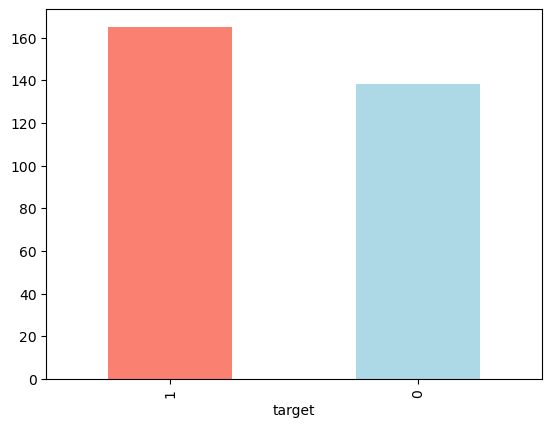

In [8]:
df.target.value_counts().plot(kind="bar", color=["salmon", "lightblue"]);

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 303 entries, 0 to 302
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       303 non-null    int64  
 1   sex       303 non-null    int64  
 2   cp        303 non-null    int64  
 3   trestbps  303 non-null    int64  
 4   chol      303 non-null    int64  
 5   fbs       303 non-null    int64  
 6   restecg   303 non-null    int64  
 7   thalach   303 non-null    int64  
 8   exang     303 non-null    int64  
 9   oldpeak   303 non-null    float64
 10  slope     303 non-null    int64  
 11  ca        303 non-null    int64  
 12  thal      303 non-null    int64  
 13  target    303 non-null    int64  
dtypes: float64(1), int64(13)
memory usage: 33.3 KB


In [10]:
#Check missing values
df.isna().sum()

age         0
sex         0
cp          0
trestbps    0
chol        0
fbs         0
restecg     0
thalach     0
exang       0
oldpeak     0
slope       0
ca          0
thal        0
target      0
dtype: int64

In [11]:
df.describe()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
count,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000
mean,54.366337,0.683168,0.966997,131.623762,246.264026,0.148515,0.528053,149.646865,0.326733,1.039604,1.399340,0.729373,2.313531,0.544554
std,9.082101,0.466011,1.032052,17.538143,51.830751,0.356198,0.525860,22.905161,0.469794,1.161075,0.616226,1.022606,0.612277,0.498835
min,29.000000,0.000000,0.000000,94.000000,126.000000,0.000000,0.000000,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,47.500000,0.000000,0.000000,120.000000,211.000000,0.000000,0.000000,133.500000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000
50%,55.000000,1.000000,1.000000,130.000000,240.000000,0.000000,1.000000,153.000000,0.000000,0.800000,1.000000,0.000000,2.000000,1.000000
75%,61.000000,1.000000,2.000000,140.000000,274.500000,0.000000,1.000000,166.000000,1.000000,1.600000,2.000000,1.000000,3.000000,1.000000
max,77.000000,1.000000,3.000000,200.000000,564.000000,1.000000,2.000000,202.000000,1.000000,6.200000,2.000000,4.000000,3.000000,1.000000


In [12]:
#Heart disease in relation to sex
df.sex.value_counts()

sex
1    207
0     96
Name: count, dtype: int64

In [13]:
# in relation to target column
pd.crosstab(df.target, df.sex)

sex,0,1
target,,
0,24,114
1,72,93


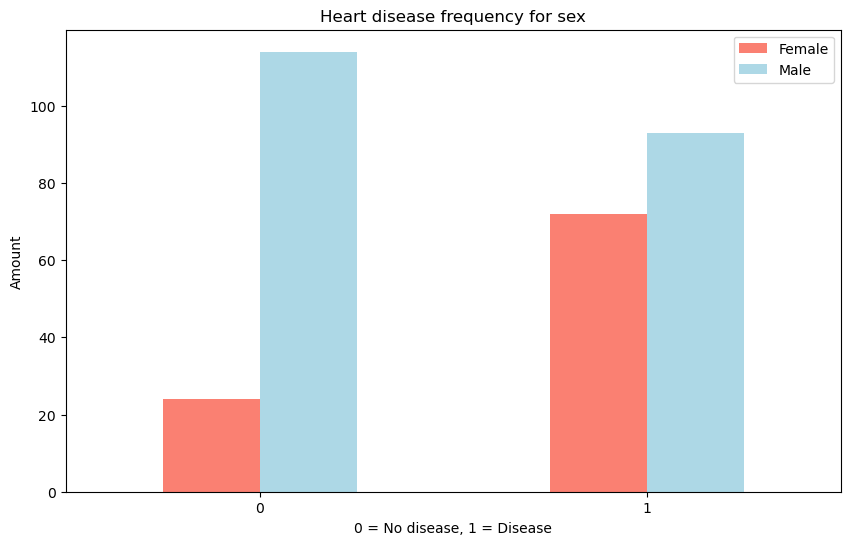

In [14]:
#Crosstab plot
pd.crosstab(df.target, df.sex).plot(kind="bar",
                                    figsize=(10,6),
                                    color=["salmon","lightblue"]);

plt.title("Heart disease frequency for sex")
plt.xlabel("0 = No disease, 1 = Disease")
plt.ylabel("Amount")
plt.legend(["Female", "Male"])
plt.xticks(rotation=0);

In [15]:
df.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1


### Age vs Max heart rate for heart disease

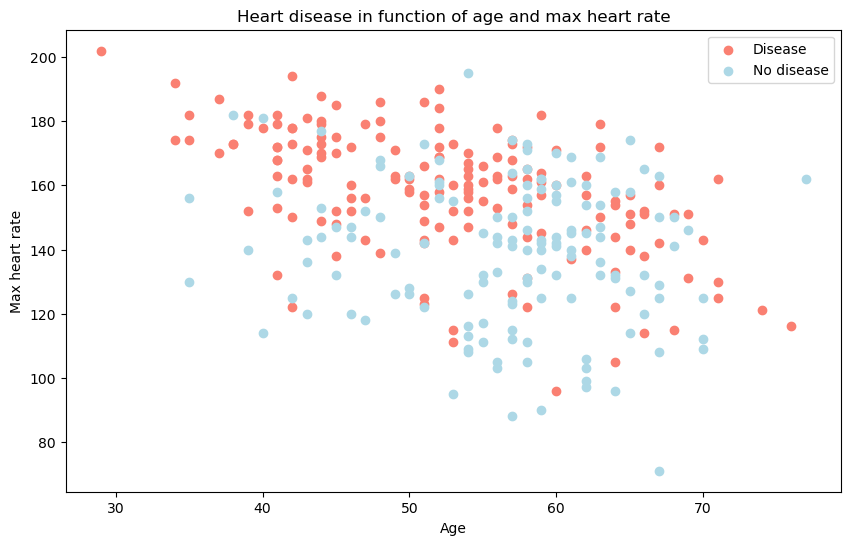

In [16]:
#creating another figure
plt.figure(figsize=(10,6))

#Scatter with positive examples
plt.scatter(df.age[df.target==1],
            df.thalach[df.target==1],
            c="salmon")

#scatter with negative examples
plt.scatter(df.age[df.target==0],
            df.thalach[df.target==0],
            c="lightblue");

# Add some helpful info
plt.title("Heart disease in function of age and max heart rate")
plt.xlabel("Age")
plt.ylabel("Max heart rate")
plt.legend(["Disease", "No disease"]);

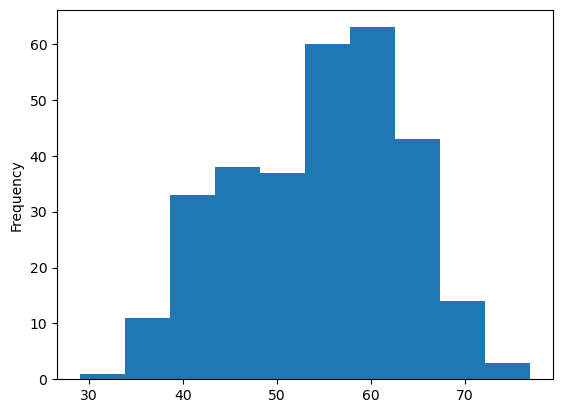

In [17]:
# Check the distribution of the age column with a histogram
df.age.plot.hist();

### Heart disease frequency per chest pain type

cp. Type of chest pain. (1=typical angina, 2= Atypical angina, 3= non-anginal pain, 4= asymptotic)

In [18]:
pd.crosstab(df.cp, df.target)

target,0,1
cp,,
0,104,39
1,9,41
2,18,69
3,7,16


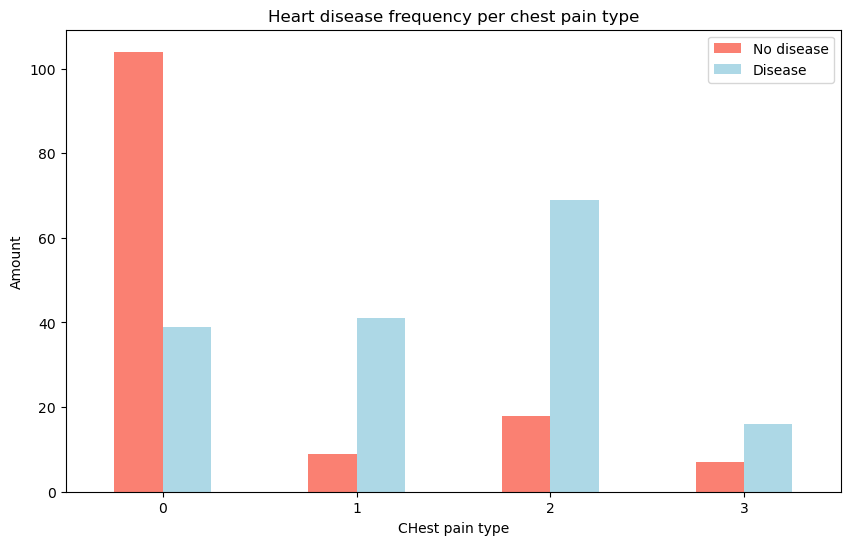

In [19]:
# Making crosstab visual
pd.crosstab(df.cp, df.target).plot(kind="bar",
                                   figsize=(10,6),
                                   color=["salmon", "lightblue"])
plt.title("Heart disease frequency per chest pain type")
plt.xlabel("CHest pain type")
plt.ylabel("Amount")
plt.legend(["No disease", "Disease"])
plt.xticks(rotation=0);

In [20]:
df.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1


In [21]:
#Correlation matrix
df.corr()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
age,1.000000,-0.098447,-0.068653,0.279351,0.213678,0.121308,-0.116211,-0.398522,0.096801,0.210013,-0.168814,0.276326,0.068001,-0.225439
sex,-0.098447,1.000000,-0.049353,-0.056769,-0.197912,0.045032,-0.058196,-0.044020,0.141664,0.096093,-0.030711,0.118261,0.210041,-0.280937
cp,-0.068653,-0.049353,1.000000,0.047608,-0.076904,0.094444,0.044421,0.295762,-0.394280,-0.149230,0.119717,-0.181053,-0.161736,0.433798
trestbps,0.279351,-0.056769,0.047608,1.000000,0.123174,0.177531,-0.114103,-0.046698,0.067616,0.193216,-0.121475,0.101389,0.062210,-0.144931
chol,0.213678,-0.197912,-0.076904,0.123174,1.000000,0.013294,-0.151040,-0.009940,0.067023,0.053952,-0.004038,0.070511,0.098803,-0.085239
fbs,0.121308,0.045032,0.094444,0.177531,0.013294,1.000000,-0.084189,-0.008567,0.025665,0.005747,-0.059894,0.137979,-0.032019,-0.028046
restecg,-0.116211,-0.058196,0.044421,-0.114103,-0.151040,-0.084189,1.000000,0.044123,-0.070733,-0.058770,0.093045,-0.072042,-0.011981,0.137230
thalach,-0.398522,-0.044020,0.295762,-0.046698,-0.009940,-0.008567,0.044123,1.000000,-0.378812,-0.344187,0.386784,-0.213177,-0.096439,0.421741
exang,0.096801,0.141664,-0.394280,0.067616,0.067023,0.025665,-0.070733,-0.378812,1.000000,0.288223,-0.257748,0.115739,0.206754,-0.436757
oldpeak,0.210013,0.096093,-0.149230,0.193216,0.053952,0.005747,-0.058770,-0.344187,0.288223,1.000000,-0.577537,0.222682,0.210244,-0.430696


## Correlation Matrix

A correlation matrix is a table showing correlation coefficients between variables. Each cell in the table shows the correlation between two variables. The value is in the range of -1 to 1. If two variables have high correlation, they have a strong relationship with each other.

### Key Points

- **Coefficient Values:**
  - `1` indicates a perfect positive correlation.
  - `-1` indicates a perfect negative correlation.
  - `0` indicates no correlation.

- **Uses:**
  - To identify relationships between variables.
  - To detect potential multicollinearity in data.
  - Useful in feature selection for machine learning.

### Example

Consider a dataset with `Age`, `Salary`, and `Years of Experience`. The correlation matrix might look like this:

|                   | Age   | Salary | Years of Experience |
|-------------------|-------|--------|---------------------|
| **Age**           | 1     | 0.75   | 0.65                |
| **Salary**        | 0.75  | 1      | 0.80                |
| **Years of Experience** | 0.65  | 0.80   | 1                 |

### Interpretation

- `Age` and `Salary` have a correlation of 0.75, suggesting a strong positive relationship.
- `Salary` and `Years of Experience` have a higher correlation of 0.80, indicating a very strong positive relationship.
- `Age` and `Years of Experience` are moderately correlated at 0.65.


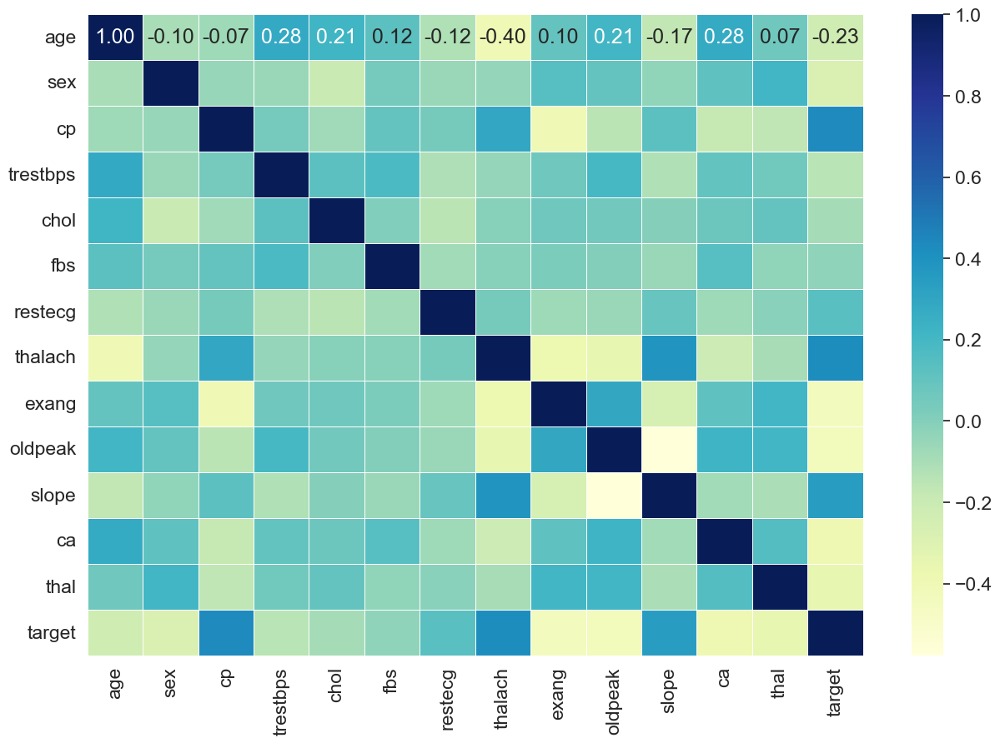

In [70]:
# Visualise correlation matrix
corr_matrix = df.corr()
fig, ax = plt.subplots(figsize=(15,10))
ax = sns.heatmap(corr_matrix,
                 annot=True,
                 linewidth=0.5,
                 fmt=".2f",
                 cmap="YlGnBu")

### Modelling 

In [23]:
df.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1


In [24]:
# Splitting data to X and y
X = df.drop("target", axis=1)
y = df["target"]

In [25]:
X.shape, y.shape

((303, 13), (303,))

In [26]:
#splitting data to train and test

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2,
                                                    random_state=42)
len(X_train), len(X_test), len(y_train), len(y_test)

(242, 61, 242, 61)

In [27]:
# models in dictionary
models = {"Logistic Regression": LogisticRegression(),
          "KNN": KNeighborsClassifier(),
          "Random Forest": RandomForestClassifier(),
          "Cat Boost Classifier": CatBoostClassifier()}

#Create a function to fit and score models
def fit_and_score(models, X_train, X_test, y_train, y_test):
    """
    Fits and evaluates given mahcine learning models.
    models: a dict to different scikit-learn machine leanring models
    X_train: training data (no labels)
    X_test: testing data (no labels)
    y_train: training labels
    y_test: test labels
    """
    #Train test split
    # X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=42)
    #Set random seed
    np.random.seed(42)
    #Dictionary to keep the model scores
    model_scores={}
    #loop through models
    for name, model in models.items():
        #Fit the model to the data
        model.fit(X_train, y_train)
        #Evaluate the model and append its score to model_scores
        model_scores[name]= model.score(X_test, y_test)
    return model_scores

In [28]:
model_scores = fit_and_score(models, X_train, X_test, y_train, y_test)
model_scores

c:\Users\Achillas\miniconda3\envs\thesis\Lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Learning rate set to 0.005621
0:	learn: 0.6884219	total: 149ms	remaining: 2m 28s
1:	learn: 0.6846994	total: 151ms	remaining: 1m 15s
2:	learn: 0.6804470	total: 153ms	remaining: 50.8s
3:	learn: 0.6762242	total: 155ms	remaining: 38.5s
4:	learn: 0.6716784	total: 157ms	remaining: 31.2s
5:	learn: 0.6672808	total: 159ms	remaining: 26.3s
6:	learn: 0.6639958	total: 160ms	remaining: 22.7s
7:	learn: 0.6601980	total: 162ms	remaining: 20.1s
8:	learn: 0.6563766	total: 164ms	remaining: 18s
9:	learn: 0.6525103	total: 166ms	remaining: 16.4s
10:	learn: 0.6483670	total: 169ms	remaining: 15.2s
11:	learn: 0.6448827	total: 171ms	remaining: 14s
12:	learn: 0.6412767	total: 172ms	remaining: 13.1s
13:	learn: 0.6374286	total: 195ms	remaining: 13.7s
14:	learn: 0.6335427	total: 197ms	remaining: 12.9s
15:	learn: 0.6288052	total: 199ms	remaining: 12.2s
16:	learn: 0.6250489	total: 200ms	remaining: 11.6s
17:	learn: 0.6209495	total: 202ms	remaining: 11s
18:	learn: 0.6181899	total: 205ms	remaining: 10.6s
19:	learn: 0.61

{'Logistic Regression': 0.8852459016393442,
 'KNN': 0.6885245901639344,
 'Random Forest': 0.8360655737704918,
 'Cat Boost Classifier': 0.8360655737704918}

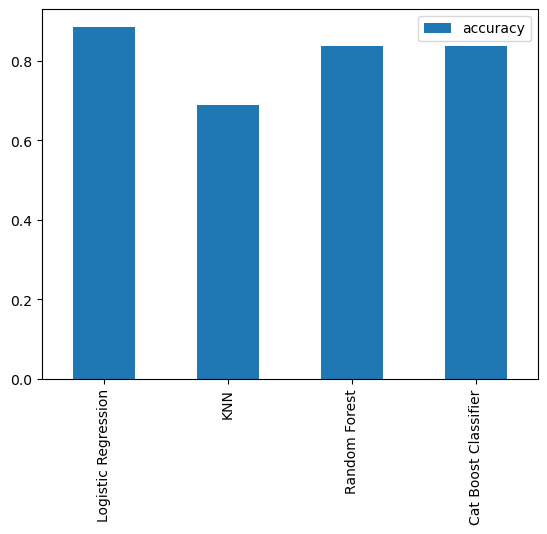

In [29]:
model_compare = pd.DataFrame(model_scores, index=["accuracy"])
model_compare.T.plot.bar();

In [30]:
model_compare

,Logistic Regression,KNN,Random Forest,Cat Boost Classifier
accuracy,0.885246,0.688525,0.836066,0.836066


### Hyperparameter tuning

In [31]:
#Let's tune KNN
train_scores = []
test_scores = []

#Create a list of different values for n_neighbors
neighbors = range(1,21)

#Setup KNN instance
knn = KNeighborsClassifier()

# Loop through different n_neighbors
for i in neighbors:
    knn.set_params(n_neighbors=i)

    #Fit the algorithm
    knn.fit(X_train, y_train)

    #Update the training scores list
    train_scores.append(knn.score(X_train, y_train))

    #Update the test scores list
    test_scores.append(knn.score(X_test,y_test))

In [32]:
train_scores

[1.0,
 0.8099173553719008,
 0.7727272727272727,
 0.743801652892562,
 0.7603305785123967,
 0.7520661157024794,
 0.743801652892562,
 0.7231404958677686,
 0.71900826446281,
 0.6942148760330579,
 0.7272727272727273,
 0.6983471074380165,
 0.6900826446280992,
 0.6942148760330579,
 0.6859504132231405,
 0.6735537190082644,
 0.6859504132231405,
 0.6652892561983471,
 0.6818181818181818,
 0.6694214876033058]

In [33]:
test_scores

[0.6229508196721312,
 0.639344262295082,
 0.6557377049180327,
 0.6721311475409836,
 0.6885245901639344,
 0.7213114754098361,
 0.7049180327868853,
 0.6885245901639344,
 0.6885245901639344,
 0.7049180327868853,
 0.7540983606557377,
 0.7377049180327869,
 0.7377049180327869,
 0.7377049180327869,
 0.6885245901639344,
 0.7213114754098361,
 0.6885245901639344,
 0.6885245901639344,
 0.7049180327868853,
 0.6557377049180327]

Maximum KNN score on the test data: 75.41%


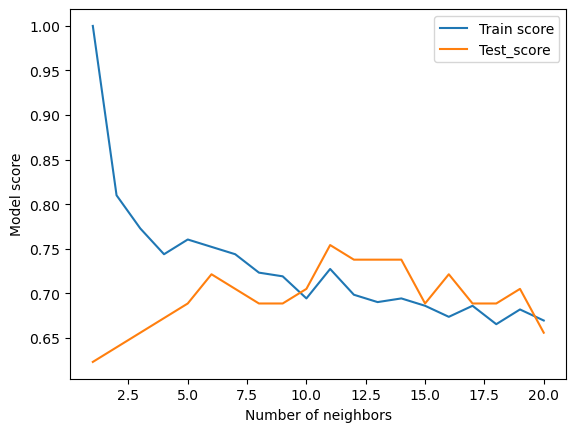

In [34]:
plt.plot(neighbors, train_scores, label = "Train score")
plt.plot(neighbors, test_scores, label = "Test_score")
plt.xlabel("Number of neighbors")
plt.ylabel("Model score")
plt.legend()

print(f"Maximum KNN score on the test data: {max(test_scores)*100:.2f}%")

### Hyperparameter tuning with RandomizedSearchCV


In [35]:
# Create a hyperparameter grid for LogisticRegression
log_reg_grid= {"C": np.logspace(-4,4,20),
               "solver": ["liblinear"]}
#Create a hyperparameter grid for RandomForestClassifier
rf_grid= {"n_estimators": np.arange(10,1000,50),
          "max_depth": [None, 3,5,10],
          "min_samples_split": np.arange(2,20,2),
          "min_samples_leaf": np.arange(1,20,2)}

cbc_grid= {"max_depth": np.arange(6,10,0.5),
           "n_estimators": np.arange(1000,10000,500),
            "l2_leaf_reg": np.arange(1,5,0.5),
            "bagging_temperature": np.arange(0.5,1,0.1)}

In [36]:
#Tune LogisticRegression
np.random.seed(42)
#Setup random hyperparameter search
rs_log_reg = RandomizedSearchCV(LogisticRegression(),
                                param_distributions=log_reg_grid,
                                cv=10,
                                n_iter=20,
                                verbose=True)

#Fit random hyperparamater
rs_log_reg.fit(X_train, y_train)

Fitting 10 folds for each of 20 candidates, totalling 200 fits


RandomizedSearchCV(cv=10, estimator=LogisticRegression(), n_iter=20,
                   param_distributions={'C': array([1.00000000e-04, 2.63665090e-04, 6.95192796e-04, 1.83298071e-03,
       4.83293024e-03, 1.27427499e-02, 3.35981829e-02, 8.85866790e-02,
       2.33572147e-01, 6.15848211e-01, 1.62377674e+00, 4.28133240e+00,
       1.12883789e+01, 2.97635144e+01, 7.84759970e+01, 2.06913808e+02,
       5.45559478e+02, 1.43844989e+03, 3.79269019e+03, 1.00000000e+04]),
                                        'solver': ['liblinear']},
                   verbose=True)

In [37]:
rs_log_reg.best_params_

{'solver': 'liblinear', 'C': 29.763514416313132}

In [38]:
rs_log_reg.score(X_test, y_test)

0.8524590163934426

In [39]:
model_scores

{'Logistic Regression': 0.8852459016393442,
 'KNN': 0.6885245901639344,
 'Random Forest': 0.8360655737704918,
 'Cat Boost Classifier': 0.8360655737704918}

In [40]:
np.random.seed(42)
rf_reg = RandomizedSearchCV(RandomForestClassifier(),
                            param_distributions= rf_grid,
                            cv=10,
                            n_iter=10,
                            verbose=True)
rf_reg.fit(X_train,y_train)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomizedSearchCV(cv=10, estimator=RandomForestClassifier(),
                   param_distributions={'max_depth': [None, 3, 5, 10],
                                        'min_samples_leaf': array([ 1,  3,  5,  7,  9, 11, 13, 15, 17, 19]),
                                        'min_samples_split': array([ 2,  4,  6,  8, 10, 12, 14, 16, 18]),
                                        'n_estimators': array([ 10,  60, 110, 160, 210, 260, 310, 360, 410, 460, 510, 560, 610,
       660, 710, 760, 810, 860, 910, 960])},
                   verbose=True)

In [41]:
np.random.seed(42)
cbc_reg = RandomizedSearchCV(CatBoostClassifier(),
                            param_distributions= cbc_grid,
                            cv=10,
                            n_iter=20,
                            verbose=True)
cbc_reg.fit(X_train,y_train)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
0:	learn: 0.6675289	total: 3.04ms	remaining: 12.2s
1:	learn: 0.6458488	total: 5.08ms	remaining: 10.2s
2:	learn: 0.6257861	total: 7.81ms	remaining: 10.4s
3:	learn: 0.6072178	total: 24.7ms	remaining: 24.7s
4:	learn: 0.5865715	total: 27ms	remaining: 21.6s
5:	learn: 0.5658420	total: 37.6ms	remaining: 25s
6:	learn: 0.5478434	total: 39.4ms	remaining: 22.5s
7:	learn: 0.5315352	total: 42.6ms	remaining: 21.2s
8:	learn: 0.5180928	total: 45.4ms	remaining: 20.1s
9:	learn: 0.5053543	total: 49.1ms	remaining: 19.6s
10:	learn: 0.4947277	total: 51.2ms	remaining: 18.6s
11:	learn: 0.4821584	total: 53.4ms	remaining: 17.7s
12:	learn: 0.4679118	total: 55.8ms	remaining: 17.1s
13:	learn: 0.4546528	total: 58.2ms	remaining: 16.6s
14:	learn: 0.4445236	total: 60ms	remaining: 15.9s
15:	learn: 0.4342292	total: 64.3ms	remaining: 16s
16:	learn: 0.4227124	total: 66.5ms	remaining: 15.6s
17:	learn: 0.4128753	total: 68.7ms	remaining: 15.2s
18:	learn: 0.403028

c:\Users\Achillas\miniconda3\envs\thesis\Lib\site-packages\sklearn\model_selection\_validation.py:425: FitFailedWarning: 
120 fits failed out of a total of 200.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
50 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Achillas\miniconda3\envs\thesis\Lib\site-packages\sklearn\model_selection\_validation.py", line 732, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Achillas\miniconda3\envs\thesis\Lib\site-packages\catboost\core.py", line 5201, in fit
    self._fit(X, y, cat_features, text_features, embedding_features, None, sample_weight, None, None, None, None, baseline, use_best_model,
  File "c:\Users\Achillas\minico

0:	learn: 0.6700744	total: 2.09ms	remaining: 15.7s
1:	learn: 0.6517205	total: 4.13ms	remaining: 15.5s
2:	learn: 0.6279612	total: 5.45ms	remaining: 13.6s
3:	learn: 0.6150812	total: 6.76ms	remaining: 12.7s
4:	learn: 0.5990536	total: 8.39ms	remaining: 12.6s
5:	learn: 0.5899058	total: 9.21ms	remaining: 11.5s
6:	learn: 0.5720516	total: 10.7ms	remaining: 11.4s
7:	learn: 0.5564194	total: 12.4ms	remaining: 11.6s
8:	learn: 0.5404417	total: 14.1ms	remaining: 11.8s
9:	learn: 0.5247387	total: 15.8ms	remaining: 11.8s
10:	learn: 0.5119350	total: 17.6ms	remaining: 12s
11:	learn: 0.4985924	total: 19.2ms	remaining: 12s
12:	learn: 0.4871086	total: 20.8ms	remaining: 12s
13:	learn: 0.4743199	total: 22.5ms	remaining: 12s
14:	learn: 0.4639119	total: 24ms	remaining: 12s
15:	learn: 0.4557161	total: 25.5ms	remaining: 11.9s
16:	learn: 0.4448072	total: 27ms	remaining: 11.9s
17:	learn: 0.4335767	total: 28.6ms	remaining: 11.9s
18:	learn: 0.4257997	total: 30.3ms	remaining: 11.9s
19:	learn: 0.4180591	total: 32ms	rem

RandomizedSearchCV(cv=10,
                   estimator=<catboost.core.CatBoostClassifier object at 0x0000017F2355B7D0>,
                   n_iter=20,
                   param_distributions={'bagging_temperature': array([0.5, 0.6, 0.7, 0.8, 0.9]),
                                        'l2_leaf_reg': array([1. , 1.5, 2. , 2.5, 3. , 3.5, 4. , 4.5]),
                                        'max_depth': array([6. , 6.5, 7. , 7.5, 8. , 8.5, 9. , 9.5]),
                                        'n_estimators': array([1000, 1500, 2000, 2500, 3000, 3500, 4000, 4500, 5000, 5500, 6000,
       6500, 7000, 7500, 8000, 8500, 9000, 9500])},
                   verbose=True)

In [42]:
rf_reg.best_params_

{'n_estimators': 610,
 'min_samples_split': 4,
 'min_samples_leaf': 15,
 'max_depth': 3}

In [43]:
rf_reg.score(X_test,y_test)

0.8688524590163934

In [44]:
cbc_reg.best_params_

{'n_estimators': 7500,
 'max_depth': 7.0,
 'l2_leaf_reg': 3.5,
 'bagging_temperature': 0.5}

In [45]:
cbc_reg.score(X_test,y_test)

0.8032786885245902

In [46]:
model_scores

{'Logistic Regression': 0.8852459016393442,
 'KNN': 0.6885245901639344,
 'Random Forest': 0.8360655737704918,
 'Cat Boost Classifier': 0.8360655737704918}

In [47]:
#Hyperparameter tuning with GridSearchCV

log_reg_grid = {"C": np.logspace(-4,4,30),
                "solver": ["liblinear"]}

#Setup grid hyperparameter search for logisticRegression
gs_log_reg = GridSearchCV(LogisticRegression(),
                          param_grid = log_reg_grid,
                          cv=5,
                          verbose=True)

# Fit grid hyperparameter search model
gs_log_reg.fit(X_train, y_train);

Fitting 5 folds for each of 30 candidates, totalling 150 fits


In [48]:
gs_log_reg.best_params_

{'C': 0.20433597178569418, 'solver': 'liblinear'}

In [49]:
gs_log_reg.score(X_test,y_test)

0.8852459016393442

In [50]:
# MAke predictions with tuned model
y_preds = gs_log_reg.predict(X_test)

In [51]:
y_preds

array([0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0,
       0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0], dtype=int64)

In [52]:
y_test

179    0
228    0
111    1
246    0
60     1
      ..
249    0
104    1
300    0
193    0
184    0
Name: target, Length: 61, dtype: int64

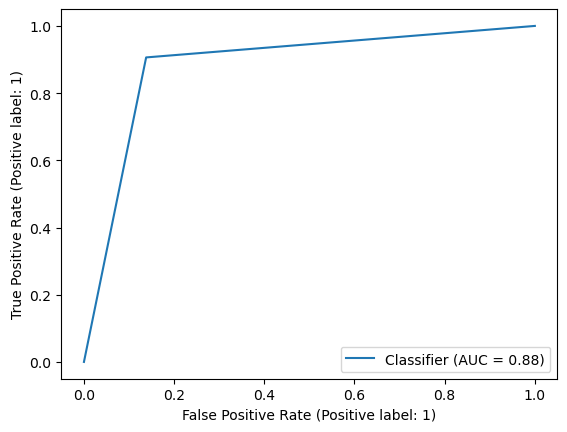

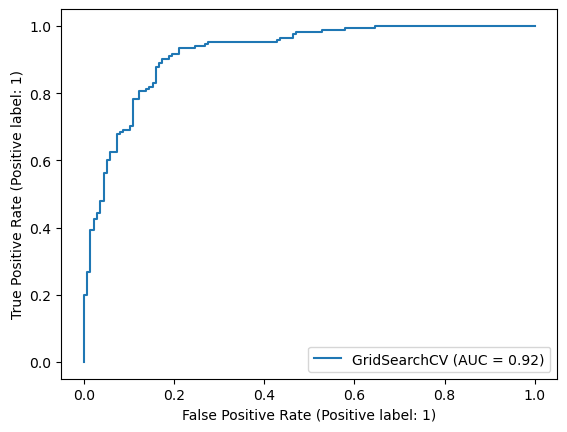

In [53]:
#Plot ROC curve
from sklearn.metrics import roc_curve
RocCurveDisplay.from_predictions(y_test,y_preds)
RocCurveDisplay.from_estimator(gs_log_reg, X, y);

In [54]:
#confusion matrix
print(confusion_matrix(y_test, y_preds))

[[25  4]
 [ 3 29]]


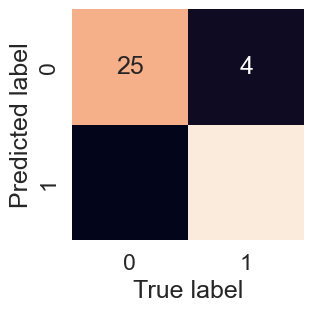

In [55]:
sns.set(font_scale=1.5)

def  plot_conf_mat(y_test,y_preds):
    """
    Plots a nice looking confiusion matrix using seaborn's heatmap()
    """
    fig, ax = plt.subplots(figsize=(3,3))
    ax = sns.heatmap(confusion_matrix(y_test,y_preds),
                     annot=True,
                     cbar=False)
    plt.xlabel("True label")
    plt.ylabel("Predicted label")
plot_conf_mat(y_test,y_preds)

## Precision, Recall, F1-Score, and Support

In the context of classification tasks, several metrics are crucial for evaluating the performance of a model. These include Precision, Recall, F1-Score, and Support.

### Precision
Precision measures the accuracy of positive predictions. Formally, it is defined as the ratio of true positives to the sum of true and false positives. This metric tells us the proportion of positive identifications that were actually correct.

**Formula:**
\[ \text{Precision} = \frac{\text{True Positives}}{\text{True Positives} + \text{False Positives}} \]

### Recall
Recall, also known as sensitivity, measures the ability of a model to find all the relevant cases (i.e., True Positives) within a dataset. It is defined as the ratio of true positives to the sum of true positives and false negatives.

**Formula:**
\[ \text{Recall} = \frac{\text{True Positives}}{\text{True Positives} + \text{False Negatives}} \]

### F1-Score
The F1-Score is the harmonic mean of Precision and Recall. It is a way to combine both precision and recall into a single measure that captures both properties. This score is particularly useful when the classes are imbalanced.

**Formula:**
\[ \text{F1-Score} = 2 \times \left( \frac{\text{Precision} \times \text{Recall}}{\text{Precision} + \text{Recall}} \right) \]

### Support
Support is the number of actual occurrences of the class in the specified dataset. It doesn’t measure the performance of a model but rather gives insight into the distribution of classes in the dataset.

### Example
Consider a binary classification for predicting if an email is spam or not. Here's how these metrics might be reported:

| Metric    | Spam | Not Spam |
|-----------|------|----------|
| Precision | 0.92 | 0.89     |
| Recall    | 0.85 | 0.94     |
| F1-Score  | 0.88 | 0.91     |
| Support   | 500  | 1000     |

### Interpretation
- **Precision:** Out of all emails predicted as spam, 92% were actually spam.
- **Recall:** Out of all actual spam emails, 85% were correctly predicted as spam.
- **F1-Score:** Combines precision and recall of the spam class into a single metric. A score of 0.88 indicates a relatively high performance of the model in classifying spam.
- **Support:** There were 500 actual spam emails in the dataset.

These metrics provide a comprehensive view of model performance, balancing the trade-off between precision and recall, and giving context to the dataset's class distribution.


In [56]:
#Classification report
print(classification_report(y_test, y_preds))

              precision    recall  f1-score   support

           0       0.89      0.86      0.88        29
           1       0.88      0.91      0.89        32

    accuracy                           0.89        61
   macro avg       0.89      0.88      0.88        61
weighted avg       0.89      0.89      0.89        61



In [57]:
gs_log_reg.best_params_

{'C': 0.20433597178569418, 'solver': 'liblinear'}

In [58]:
#Create new classifier
clf = LogisticRegression(C=0.20433597178569418,
                         solver= "liblinear")


In [59]:
#Cross val accuracy
cv_acc = cross_val_score(clf,
                         X,
                         y,
                         cv=5,
                         scoring="accuracy")
cv_acc

array([0.81967213, 0.90163934, 0.86885246, 0.88333333, 0.75      ])

In [60]:
cv_acc = np.mean(cv_acc)
cv_acc

0.8446994535519124

In [61]:
#Cross-validated precision
cv_precision = cross_val_score(clf,
                               X,
                               y,
                               cv=5,
                               scoring="precision")
cv_precision= np.mean(cv_precision)
cv_precision

0.8207936507936507

In [62]:
#Cross-validated recall
cv_recall = cross_val_score(clf,
                            X,
                            y,
                            cv=5,
                            scoring="recall")
cv_recall = np.mean(cv_recall)
cv_recall

0.9212121212121213

In [63]:
#cross-validated F1-score
cv_f1 = cross_val_score(clf,
                        X,
                        y,
                        cv=5,
                        scoring="f1")
cv_f1 = np.mean(cv_f1)
cv_f1

0.8673007976269721

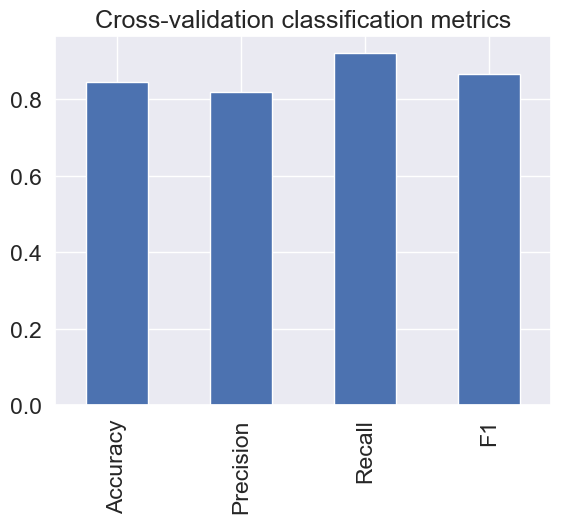

In [64]:
# Visualize cross-validated meterics
cv_metrics = pd.DataFrame({"Accuracy": cv_acc,
                          "Precision": cv_precision,
                          "Recall": cv_recall,
                          "F1": cv_f1},
                         index=[0])
cv_metrics.T.plot.bar(title="Cross-validation classification metrics",
                     legend=False);

### Feature importance

In [65]:
# Fit an instance of LogisticRegression
clf = LogisticRegression(C=0.20433597178569418,
                         solver= "liblinear")
clf.fit(X_train,y_train);

In [66]:
df.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1


In [67]:
#Check coef_
clf.coef_

array([[ 0.00316728, -0.86044652,  0.6606704 , -0.01156993, -0.00166375,
         0.04386107,  0.31275848,  0.02459362, -0.60413081, -0.56862803,
         0.45051628, -0.63609898, -0.67663373]])

In [68]:
# Match coef's of features to columns
feature_dict = dict(zip(df.columns, list(clf.coef_[0])))
feature_dict

{'age': 0.0031672806268220445,
 'sex': -0.8604465226286001,
 'cp': 0.6606703996492814,
 'trestbps': -0.011569930743501303,
 'chol': -0.001663745833540806,
 'fbs': 0.043861067871676124,
 'restecg': 0.3127584791782968,
 'thalach': 0.02459361509185037,
 'exang': -0.6041308102637141,
 'oldpeak': -0.5686280255489925,
 'slope': 0.4505162810238786,
 'ca': -0.6360989756865822,
 'thal': -0.67663372723561}

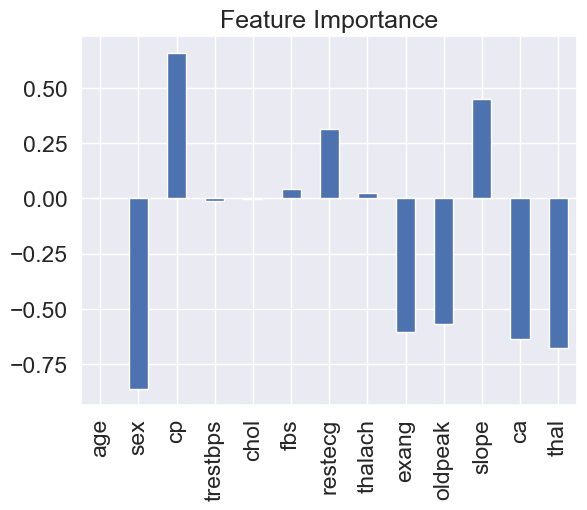

In [69]:
# Visualise feature importance
feature_df = pd.DataFrame(feature_dict, index=[0])
feature_df.T.plot.bar(title="Feature Importance", legend=False);